In [3]:
import os
import glob
import sys
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from astropy.io import fits
from astropy.table import Table
from astropy.wcs import WCS
from astropy import units as u
from astropy.coordinates import SkyCoord
import importlib

In [4]:
sys.path.append('/global/common/software/m4943/grizli0/observing-program/py/')

In [5]:
code_data_dir = '/global/common/software/m4943/grizli0/observing-program/data/'
import roman_coords_transform as ctrans
rctrans = ctrans.RomanCoordsTransform(file_path=code_data_dir)

In [6]:
import grism_dispersion

In [7]:
import footprintutils as fp

In [60]:
importlib.reload(fp)

<module 'footprintutils' from '/Users/ross.1333/Documents/GitHub/observing-program/py/footprintutils.py'>

In [8]:
rctrans = ctrans.RomanCoordsTransform(file_path=code_data_dir)

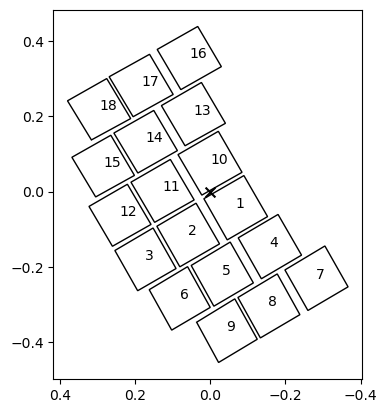

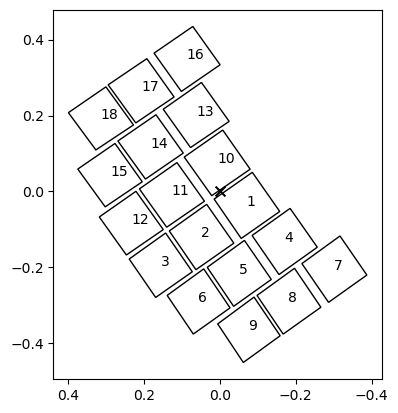

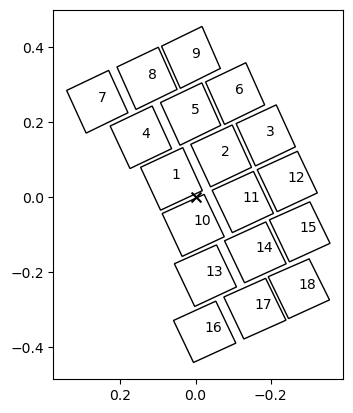

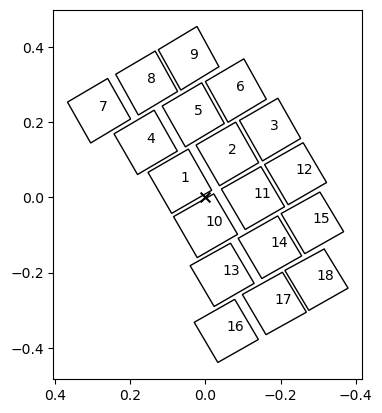

In [9]:
#RA = 119.553626911345
#Dec = -60.801287288033194
#PA = 35.
RA = 0
Dec = 0
#PA = 0
PAs = [0,5,175,180]
for PA in PAs:
    dfoot = rctrans.wfi_sky_pointing(RA, Dec, PA, ds9=False)

In [10]:
dfoot[0]

{'rot': array([[ 0.5      ,  0.8660254],
        [-0.8660254,  0.5      ]]),
 'PA': 180,
 1: {'ra_cen': 0.06754295895060194,
  'dec_cen': 0.04298780366869513,
  'centers': [0.06754293994002422, 0.04298780366869513],
  'vertices': array([[ 0.15273662,  0.0665474 ],
         [ 0.04534948,  0.1285474 ],
         [-0.01678461,  0.0189282 ],
         [ 0.08973654, -0.0425718 ]])},
 2: {'ra_cen': -0.058896889694254384,
  'dec_cen': 0.11598780366869516,
  'centers': [-0.058896769012503805, 0.11598780366869516],
  'vertices': array([[ 0.02493085,  0.13918138],
         [-0.08072481,  0.20018138],
         [-0.14185848,  0.09229423],
         [-0.03756922,  0.0309282 ]])},
 3: {'ra_cen': -0.1728469557761077,
  'dec_cen': 0.18062177826491072,
  'centers': [-0.17284609690826525, 0.18062177826491072],
  'vertices': array([[-0.09075118,  0.20481535],
         [-0.19294364,  0.26381535],
         [-0.25357652,  0.15679423],
         [-0.15188479,  0.0969282 ]])},
 4: {'ra_cen': 0.15842614302113286,


In [11]:
htest = fp.fake_header(53.22491146968, -27.82350140649,crota2=0)
wtest = WCS(htest)
wtest

WCS Keywords

Number of WCS axes: 2
CTYPE : 'RA---TAN' 'DEC--TAN' 
CRVAL : 53.22491146968 -27.82350140649 
CRPIX : 2044.0 2044.0 
CD1_1 CD1_2  : -3.0555555555555e-05 -0.0 
CD2_1 CD2_2  : -0.0 3.05555555555555e-05 
NAXIS : 4088  4088

In [12]:
htest = fp.fake_header(53.22491146968, -27.82350140649,crota2=180)
wtest180 = WCS(htest)
wtest180

WCS Keywords

Number of WCS axes: 2
CTYPE : 'RA---TAN' 'DEC--TAN' 
CRVAL : 53.22491146968 -27.82350140649 
CRPIX : 2044.0 2044.0 
CD1_1 CD1_2  : 3.05555555555555e-05 -3.741976330728e-21 
CD2_1 CD2_2  : -3.741976330728e-21 -3.0555555555555e-05 
NAXIS : 4088  4088

In [13]:
ra,dec = 53.22491146968,-27.81
coords_test = SkyCoord(ra=ra*u.degree,dec=dec*u.degree, frame='icrs')
print(wtest.world_to_pixel(coords_test))
print(wtest180.world_to_pixel(coords_test))

(array(2043.), array(2484.86422058))
(array(2043.), array(1601.13577942))


In [14]:
wtest.pixel_to_world([1],[4]),wtest180.pixel_to_world([1],[4]),wtest.pixel_to_world([4000],[4000]),wtest180.pixel_to_world([4000],[4000])

(<SkyCoord (ICRS): (ra, dec) in deg
     [(53.2955028, -27.88578618)]>,
 <SkyCoord (ICRS): (ra, dec) in deg
     [(53.15440111, -27.76118077)]>,
 <SkyCoord (ICRS): (ra, dec) in deg
     [(53.15733461, -27.76368778)]>,
 <SkyCoord (ICRS): (ra, dec) in deg
     [(53.29256282, -27.8832821)]>)

In [15]:
#min_lam_4foot = 10000
#max_lam_4foot = 19300
#all_dx = np.arange(-400,600)

In [16]:
sys.path.append('/global/common/software/m4943/grizli0/grism_sim/py/')
os.environ["WEBBPSF_PATH"]="/global/cfs/cdirs/m4943/grismsim/webbpsf-data"
os.environ['github_dir']='/global/common/software/m4943/grizli0/'
import optical_model

In [17]:
optmod = optical_model.RomanOpticalModel()

In [18]:
def test_foot(xpix,ypix,min_pix=0,max_pix=4088,det=1):
    #conf = grism_dispersion.aXeConf(conf_file=roman_base_dir+"configuration/Roman.det"+str(det)+".07242020.conf")
    #dy,lam = conf.get_beam_trace(x=xpix, y=ypix, dx=all_dx, beam='A')
    #sel_lam = lam > max_lam_4foot
    #sel_lam |= lam < min_lam_4foot
    #dx_sel = all_dx[~sel_lam]
    #dy_sel = dy[~sel_lam]
    test = optmod._get_beam_trace(xpix,ypix,det,width=1)
    
    #if xpix+dx_sel[0] >= 0 and xpix+dx_sel[-1] < 4088 and ypix+dy_sel[0] >= 0 and ypix+dy_sel[-1] < 4088 and ypix+dy_sel[0] < 4088 and ypix+dy_sel[-1] >= 0:
    if np.min(test['trace_pix_x'][0])>=min_pix and np.max(test['trace_pix_x'][0]) < max_pix and np.min(test['trace_pix_y'][0])>=min_pix and np.max(test['trace_pix_y'][0]) < max_pix:
        return 1
    else:
        return 0

In [22]:
test_foot(500,701)

1

In [23]:
def mkgrid(ra,dec,sz,res):    
    ral = np.arange(ra-sz/2,ra+sz/2,sz/res)
    decl = np.arange(dec-sz/2,dec+sz/2,sz/res)
    if len(ral) != len(decl):
        print('error, mismatched ra/dec lists!')
        return
    ral_tot  = []
    decl_tot = []
    for i in range(0,len(ral)):
        for j in range(0,len(ral)):
            ral_tot.append(ral[i])
            decl_tot.append(decl[j])
    return ral_tot,decl_tot

In [36]:
ral_tot,decl_tot = mkgrid(0,0,1,1000)

In [38]:
coords = SkyCoord(ra=ral_tot*u.degree,dec=decl_tot*u.degree, frame='icrs')

In [26]:
def get_pixl(coords,detfoot,detnum,PA):
    ra = detfoot[0][int(detnum)]['ra_cen']
    dec = detfoot[0][int(detnum)]['dec_cen']
    h = fp.fake_header(ra, dec,crota2=PA)
    w = WCS(h)
    pixels = w.world_to_pixel(coords)
    return pixels

1 60
2 60
3 60
4 60
5 60
6 60
7 60
8 60
9 60
10 60
11 60
12 60
13 60
14 60
15 60
16 60
17 60
18 60
1 65
2 65
3 65
4 65
5 65
6 65
7 65
8 65
9 65
10 65
11 65
12 65
13 65
14 65
15 65
16 65
17 65
18 65
1 235
2 235
3 235
4 235
5 235
6 235
7 235
8 235
9 235
10 235
11 235
12 235
13 235
14 235
15 235
16 235
17 235
18 235
1 240
2 240
3 240
4 240
5 240
6 240
7 240
8 240
9 240
10 240
11 240
12 240
13 240
14 240
15 240
16 240
17 240
18 240


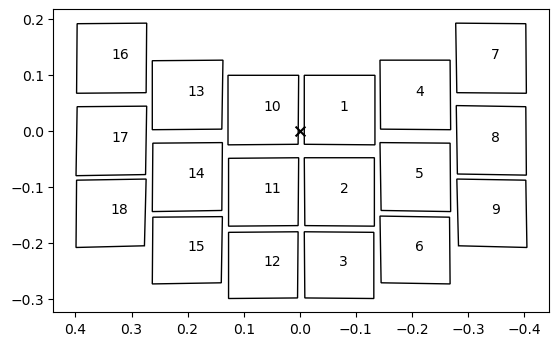

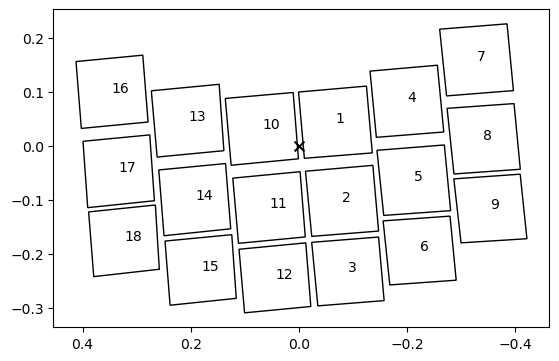

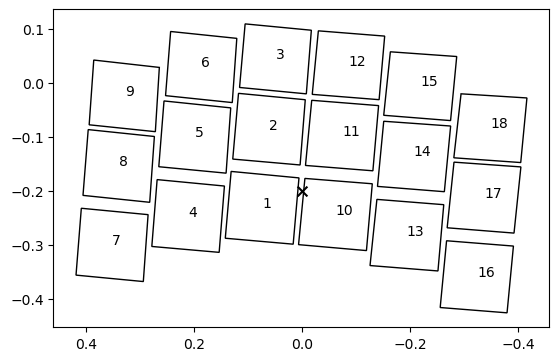

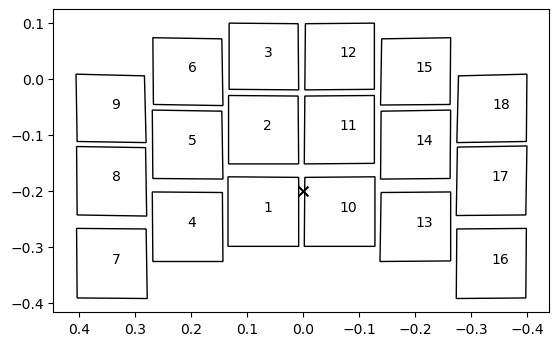

In [41]:
nobs = np.zeros(len(ral_tot))
pa_off = 60
rolls = [0+pa_off,5+pa_off,175+pa_off,180+pa_off]
dec_offs = [0,0,-.2,-.2]
ra = 0
dec = 0
nc = 10
dets = np.arange(1,19)
for PA,dec_off in zip(rolls,dec_offs):
    dfoot = rctrans.wfi_sky_pointing(ra, dec+dec_off, PA, ds9=False)
    for det in dets:
        pixels = get_pixl(coords,dfoot,det,PA-pa_off)
        for i in range(0,len(pixels[0])):
            xpix = pixels[0][i]
            ypix = pixels[1][i]
            test = 0
            if xpix > -1000 and xpix < 5088 and ypix > -1000 and ypix < 5088:
                test = test_foot(xpix,ypix,det=det)
            nobs[i] += test
            #if i % (len(pixels[0])/nc) == 0:
        print(det,PA)

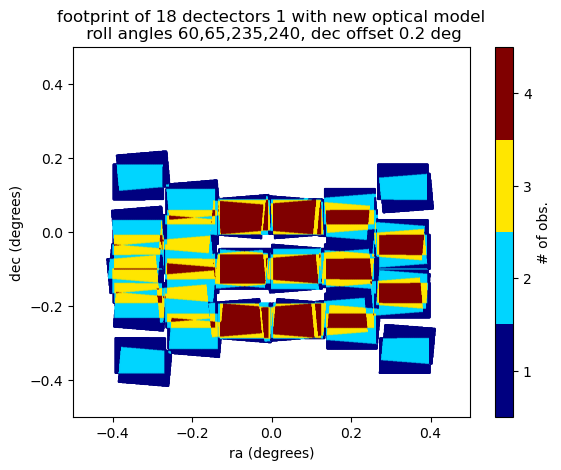

In [43]:
cmap = plt.get_cmap('jet', 4)
sel = nobs > 0
plt.scatter(np.array(ral_tot)[sel],np.array(decl_tot)[sel],c=nobs[sel],s=.1,cmap=cmap,vmin=0.5,vmax=4.5)
plt.colorbar(ticks=np.arange(1,5 ),label='# of obs.')#norm=norm, cmap=cmap)#,cax=ax)#,
#             cax=ax, orientation='horizontal',
#             label="Discrete intervals with extend='both' keyword")
#plt.colorbar(levels=[0,1,2,3,4])
plt.xlim(min(ral_tot),max(ral_tot))
plt.ylim(min(decl_tot),max(decl_tot))
plt.xlabel('ra (degrees)')
plt.ylabel('dec (degrees)')
plt.title(r'footprint of 18 dectectors 1 with new optical model'+'\n roll angles 60,65,235,240, dec offset 0.2 deg')
plt.show()

In [44]:
ral_tot,decl_tot = mkgrid(10,0,2,1000)

In [45]:
coords = SkyCoord(ra=ral_tot*u.degree,dec=decl_tot*u.degree, frame='icrs')

0 60 0 0 0
0 60 0 0 1
0 60 0 1 0
0 60 0 1 1
0 60 0 2 0
0 60 0 2 1
0 60 0 3 0
0 60 0 3 1
0 60 1 0 0
0 60 1 0 1
0 60 1 1 0
0 60 1 1 1
0 60 1 2 0
0 60 1 2 1
0 60 1 3 0
0 60 1 3 1
0 65 0 0 0
0 65 0 0 1
0 65 0 1 0
0 65 0 1 1
0 65 0 2 0
0 65 0 2 1
0 65 0 3 0
0 65 0 3 1
0 65 1 0 0
0 65 1 0 1
0 65 1 1 0
0 65 1 1 1
0 65 1 2 0
0 65 1 2 1
0 65 1 3 0
0 65 1 3 1
0 235 0 0 0
0 235 0 0 1
0 235 0 1 0
0 235 0 1 1
0 235 0 2 0
0 235 0 2 1
0 235 0 3 0
0 235 0 3 1
0 235 1 0 0
0 235 1 0 1
0 235 1 1 0
0 235 1 1 1
0 235 1 2 0
0 235 1 2 1
0 235 1 3 0
0 235 1 3 1
0 240 0 0 0
0 240 0 0 1
0 240 0 1 0
0 240 0 1 1
0 240 0 2 0
0 240 0 2 1
0 240 0 3 0
0 240 0 3 1
0 240 1 0 0
0 240 1 0 1
0 240 1 1 0
0 240 1 1 1
0 240 1 2 0
0 240 1 2 1
0 240 1 3 0
0 240 1 3 1
1 60 0 0 0
1 60 0 0 1
1 60 0 1 0
1 60 0 1 1
1 60 0 2 0
1 60 0 2 1
1 60 0 3 0
1 60 0 3 1
1 60 1 0 0
1 60 1 0 1
1 60 1 1 0
1 60 1 1 1
1 60 1 2 0
1 60 1 2 1
1 60 1 3 0
1 60 1 3 1
1 65 0 0 0
1 65 0 0 1
1 65 0 1 0
1 65 0 1 1
1 65 0 2 0
1 65 0 2 1
1 65 0 3 0
1 65 0 3 1


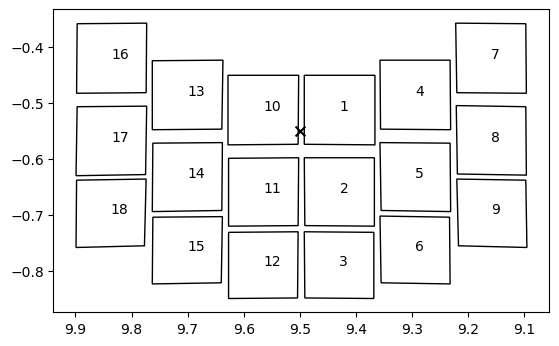

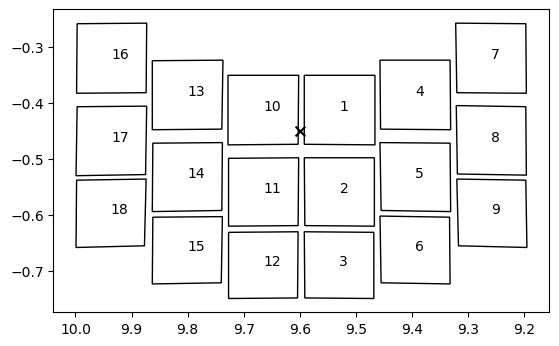

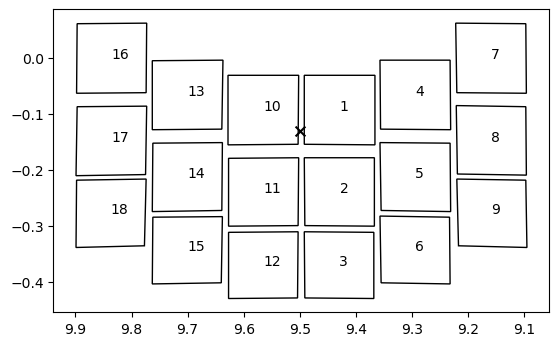

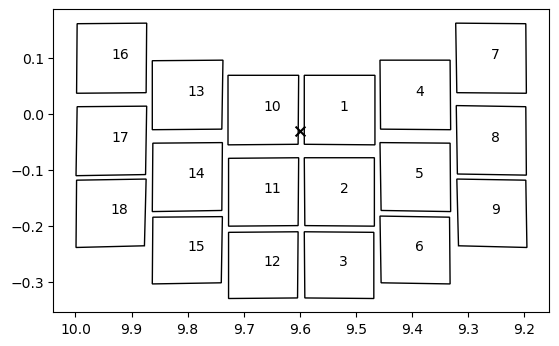

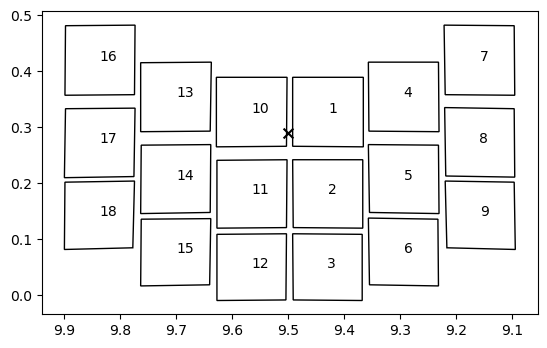

...

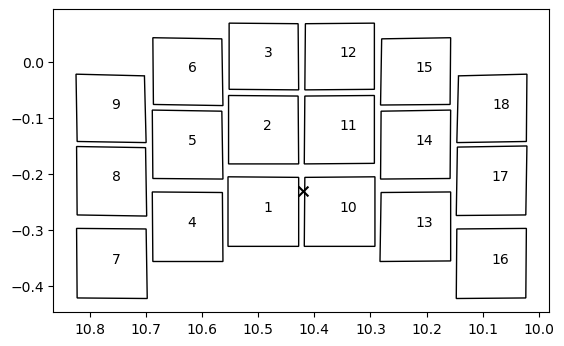

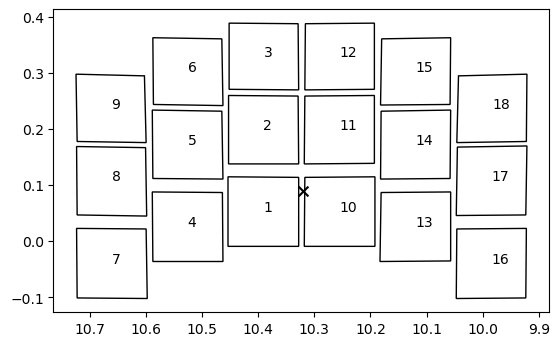

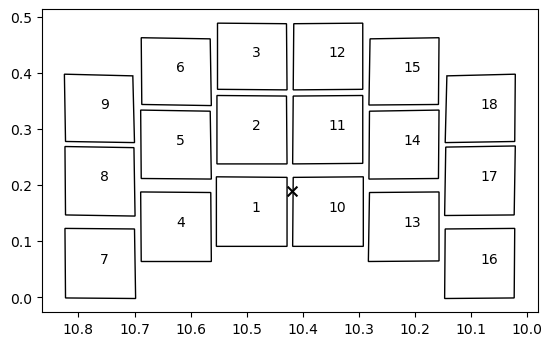

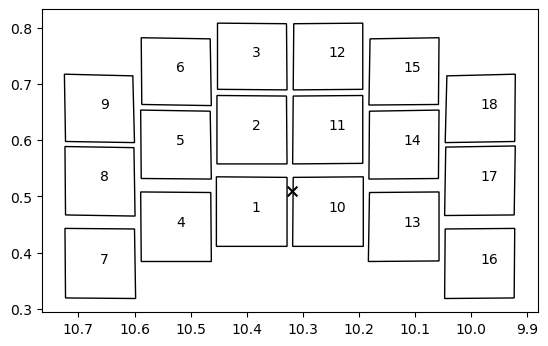

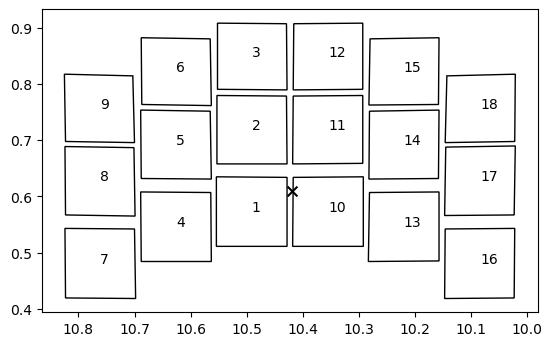

In [51]:
nobs = np.zeros(len(ral_tot))
pa_off = 60
ra0 = 9.5
dec0 = -.65
decstep = .42
rastep = .82
dithstep = 0.1,0.1 #ra,dec step for dither
ndith = 2
decpa = 0.2 #how much offset there is in declination between 0 and 180 pa
ndec = 4 #number of "rows"
nra = 2 #number of "columns"

pa_off = 60 #new code shifted by 60
pal = [0+pa_off,5+pa_off,175+pa_off,180+pa_off] #position angles
ndet=18
for det in range(0,ndet):
    for pa in pal:
        decoff = decpa/2
        if pa > 100:
            decoff = -decpa/2
        for raind in range(0,nra):
            for decind in range(0,ndec):
                for dithind in range(0,ndith):
                    ra = round(ra0+raind*rastep+dithind*dithstep[0],4)
                    dec = round(dec0+decstep*decind+decoff+dithind*dithstep[1],4)
                    dfoot = rctrans.wfi_sky_pointing(ra, dec, pa, ds9=False)
                    pixels = get_pixl(coords,dfoot,det+1,pa-pa_off)
                    for i in range(0,len(pixels[0])):
                        xpix = pixels[0][i]
                        ypix = pixels[1][i]
                        test = 0
                        if xpix > -1000 and xpix < 5088 and ypix > -1000 and ypix < 5088:
                            test = test_foot(xpix,ypix,det=det+1)
                        nobs[i] += test
            #if i % (len(pixels[0])/nc) == 0:
                    print(det,pa,raind,decind,dithind)

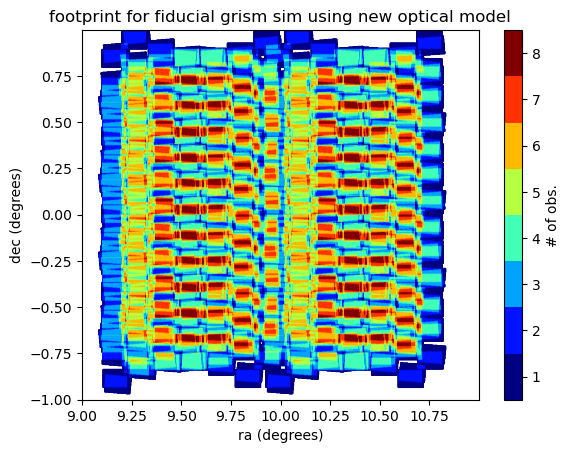

In [58]:
cmap = plt.get_cmap('jet', 8)
sel = nobs > 0
plt.scatter(np.array(ral_tot)[sel],np.array(decl_tot)[sel],c=nobs[sel],s=.1,cmap=cmap,vmin=0.5,vmax=8.5)
plt.colorbar(ticks=np.arange(1,9 ),label='# of obs.')#norm=norm, cmap=cmap)#,cax=ax)#,
#             cax=ax, orientation='horizontal',
#             label="Discrete intervals with extend='both' keyword")
#plt.colorbar(levels=[0,1,2,3,4])
plt.xlim(min(ral_tot),max(ral_tot))
plt.ylim(min(decl_tot),max(decl_tot))
plt.xlabel('ra (degrees)')
plt.ylabel('dec (degrees)')
plt.title(r'footprint for fiducial grism sim using new optical model')
plt.show()

In [56]:
for n in range(0,8):
    sel_n = nobs > n
    print(np.sum(sel_n)/len(nobs))

0.779036
0.733759
0.64007
0.514075
0.360075
0.242592
0.122175
0.044736


In [ ]:
rolls = [0,5,175,180]
dets = np.arange(1,19)

pix_list = []
for roll in rolls:
    h = fp.fake_header(0, 0,crota2=roll)
    w = WCS(h)
    pixels = w.world_to_pixel(coords)
    pix_list.append(pixels)

In [96]:
nc = 10
npix = len(pix_list[0][0])
3 % (npix/nc)

3.0

In [97]:
3%100000

3

In [98]:
nobs = np.zeros(len(ral_tot))
for pixels in pix_list:
    for i in range(0,len(pixels[0])):
        xpix = pixels[0][i]
        ypix = pixels[1][i]
        test = test_foot(xpix,ypix)
        nobs[i] += test
        if i % (npix/nc) == 0:
            print(i,npix)

0 1000000
100000 1000000
200000 1000000
300000 1000000
400000 1000000
500000 1000000
600000 1000000
700000 1000000
800000 1000000
900000 1000000
0 1000000
100000 1000000
200000 1000000
300000 1000000
400000 1000000
500000 1000000
600000 1000000
700000 1000000
800000 1000000
900000 1000000
0 1000000
100000 1000000
200000 1000000
300000 1000000
400000 1000000
500000 1000000
600000 1000000
700000 1000000
800000 1000000
900000 1000000
0 1000000
100000 1000000
200000 1000000
300000 1000000
400000 1000000
500000 1000000
600000 1000000
700000 1000000
800000 1000000
900000 1000000


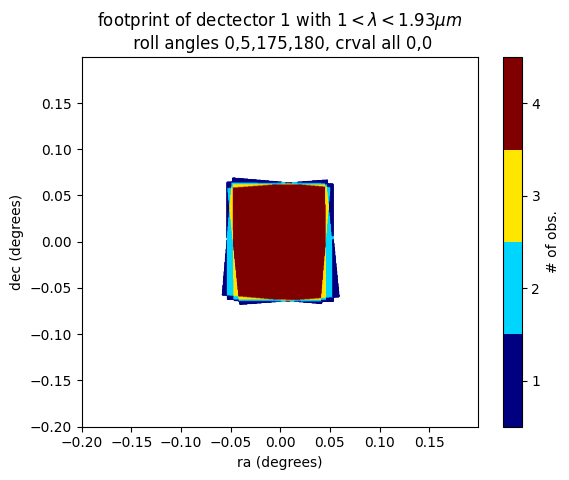

In [99]:
#fig, ax = plt.subplots()

#cmap = mpl.cm.viridis
#bounds = [0,1,2,3,4]
#norm = mpl.colors.BoundaryNorm(bounds, cmap.N, extend='both')
cmap = plt.get_cmap('jet', 4)
sel = nobs > 0
plt.scatter(np.array(ral_tot)[sel],np.array(decl_tot)[sel],c=nobs[sel],s=.1,cmap=cmap,vmin=0.5,vmax=4.5)
plt.colorbar(ticks=np.arange(1,5 ),label='# of obs.')#norm=norm, cmap=cmap)#,cax=ax)#,
#             cax=ax, orientation='horizontal',
#             label="Discrete intervals with extend='both' keyword")
#plt.colorbar(levels=[0,1,2,3,4])
plt.xlim(min(ral_tot),max(ral_tot))
plt.ylim(min(decl_tot),max(decl_tot))
plt.xlabel('ra (degrees)')
plt.ylabel('dec (degrees)')
plt.title(r'footprint of dectector 1 with $1<\lambda<1.93 \mu m$'+'\n roll angles 0,5,175,180, crval all 0,0')
plt.show()

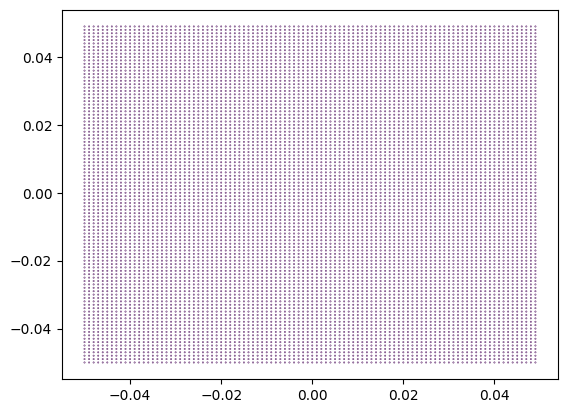

In [ ]:
sky = w.pixel_to_world(30, 40)

In [37]:
sky.ra.degree,sky.dec.degree

(53.21898674983362, -27.82369153090185)

In [39]:
w.world_to_pixel(sky)

(array(30.), array(40.))

In [134]:
w170.world_to_pixel(sky)

(array(30.), array(40.))

1

In [49]:
w.world_to_pixel(SkyCoord(ra=53.218987*u.degree, dec=-27.82369*u.degree, frame='icrs'))

(array(30.15953453), array(39.85036192))

In [67]:
w.world_to_pixel(SkyCoord(ra=53.2*u.degree, dec=-27.85*u.degree, frame='icrs'))

(array(-3860.70975335), array(1391.98827722))

In [69]:
mask = np.zeros((100,100),dtype=bool)

In [127]:
pixels = w.world_to_pixel(coords)

In [98]:
len(pixels[0])

10000

In [104]:
min(pixels[1]),max(pixels[1])

(-4063.3623357724837, 15178.972042855748)

In [117]:
ral_tot[0].value

53.2

In [128]:
ra_inl = []
dec_inl = []
ra_outl = []
dec_outl = []

for i in range(0,len(pixels[0])):
    xpix = pixels[0][i]
    ypix = pixels[1][i]
    test = test_foot(xpix,ypix)
    if test == 1:
        ra_inl.append(ral_tot[i].value)
        dec_inl.append(decl_tot[i].value)
    else:
        ra_outl.append(ral_tot[i].value)
        dec_outl.append(decl_tot[i].value)
        

In [132]:
pixels170 = w170.world_to_pixel(coords)

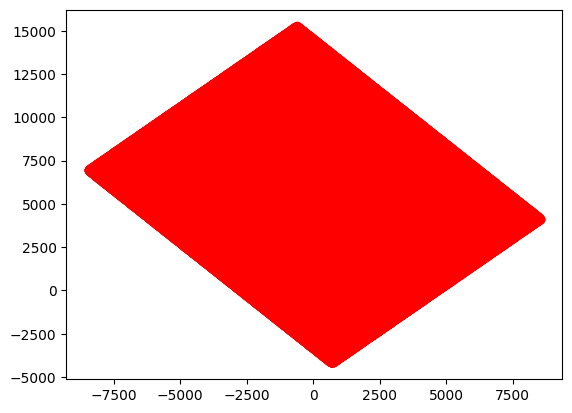

In [133]:
plt.plot(pixels170[0],pixels170[1],'ro')
plt.show()

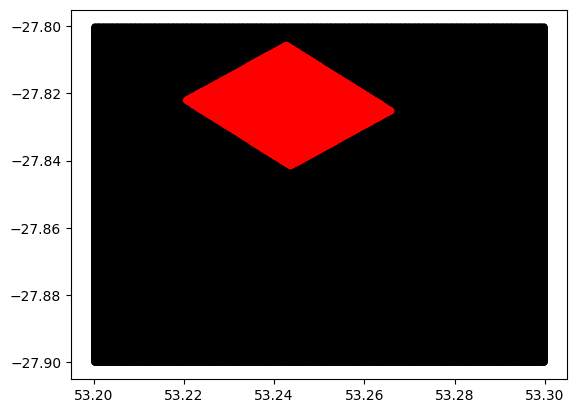

In [129]:
plt.plot(ra_outl,dec_outl,'k.')
plt.plot(ra_inl,dec_inl,'r.')
plt.show()

In [113]:
ra_inl.degree

AttributeError: 'list' object has no attribute 'degree'

In [26]:
myconf.orders['A']

2

In [29]:
lam

array([20536.53672434, 20525.56307763, 20514.58936853, 20503.61559706,
       20492.64176321, 20481.66786699, 20470.69390838, 20459.7198874 ,
       20448.74580404, 20437.77165831, 20426.79745019, 20415.8231797 ,
       20404.84884683, 20393.87445158, 20382.89999395, 20371.92547395,
       20360.95089157, 20349.97624681, 20339.00153967, 20328.02677015,
       20317.05193826, 20306.07704399, 20295.10208734, 20284.12706831,
       20273.1519869 , 20262.17684312, 20251.20163696, 20240.22636841,
       20229.25103749, 20218.2756442 , 20207.30018852, 20196.32467047,
       20185.34909003, 20174.37344722, 20163.39774203, 20152.42197446,
       20141.44614452, 20130.47025219, 20119.49429749, 20108.5182804 ,
       20097.54220094, 20086.5660591 , 20075.58985488, 20064.61358829,
       20053.63725931, 20042.66086796, 20031.68441422, 20020.70789811,
       20009.73131962, 19998.75467875, 19987.7779755 , 19976.80120987,
       19965.82438186, 19954.84749148, 19943.87053871, 19932.89352357,
      

In [30]:
sel_lam = lam > max_lam_4foot
sel_lam |= lam < min_lam_4foot

In [31]:
dx_sel = all_dx[~sel_lam]

In [32]:
dx_sel

array([-287, -286, -285, -284, -283, -282, -281, -280, -279, -278, -277,
       -276, -275, -274, -273, -272, -271, -270, -269, -268, -267, -266,
       -265, -264, -263, -262, -261, -260, -259, -258, -257, -256, -255,
       -254, -253, -252, -251, -250, -249, -248, -247, -246, -245, -244,
       -243, -242, -241, -240, -239, -238, -237, -236, -235, -234, -233,
       -232, -231, -230, -229, -228, -227, -226, -225, -224, -223, -222,
       -221, -220, -219, -218, -217, -216, -215, -214, -213, -212, -211,
       -210, -209, -208, -207, -206, -205, -204, -203, -202, -201, -200,
       -199, -198, -197, -196, -195, -194, -193, -192, -191, -190, -189,
       -188, -187, -186, -185, -184, -183, -182, -181, -180, -179, -178,
       -177, -176, -175, -174, -173, -172, -171, -170, -169, -168, -167,
       -166, -165, -164, -163, -162, -161, -160, -159, -158, -157, -156,
       -155, -154, -153, -152, -151, -150, -149, -148, -147, -146, -145,
       -144, -143, -142, -141, -140, -139, -138, -1